<a href="https://colab.research.google.com/github/abdelhadi-12/analyse-reseau-github/blob/main/reseausocial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

***Yosra Abdelwahed ***

**1er master BC**

***Rapport du projet réseau sociaux  ***

Pour l'analyse sociale j'ai choisi le réseau GitHub constitué de deux fichiers .csv

Ce code contient 2 parties:

**1.   Partie 1 : Collecte des données**
https://snapworld.stanford.edu/data/github-social.html




*  Fichier 1: musae_git_edges (id_1, id_2)

   C’est un fichier d’arêtes qui représente les connexions entre utilisateurs utilisé pour construire le graphe principal.
*   Fichier 2: musae_git_target (id, name, ml_target)
C’est un fichier qui contient les caractéristiques des nœuds (nom, cible pour machine learning), utilisé pour ajouter des attributs aux nœuds, faire de l’analyse supervisée si ml_target est une étiquette

**2.  Partie 2 : Analyse du réseau**


1.   L’analyse de la distribution des degrés
2.  L’analyse des composants connectés

1.   L’analyse des chemins
2.   Le coefficient de clustering et l’analyse de la densité

1.   L’analyse de la centralité





















 NetworkX : pour manipuler les graphes

Matplotlib : pour afficher les graphes

# **Importation bibliothèques et la base de données**

In [ ]:
pip install networkx matplotlib

In [ ]:
from google.colab import files
uploaded= files.upload()

Saving musae_git_edges.csv to musae_git_edges.csv


In [ ]:
from google.colab import files
uploaded= files.upload()

Saving musae_git_target.csv to musae_git_target.csv


#  **Partie 1: Distribution des degrés**





In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx

Étape 1 : Construire le graphe à partir des arêtes

In [ ]:
import networkx as nx
edges_df = pd.read_csv('musae_git_edges.csv')
G = nx.Graph()
G.add_edges_from(edges_df[['id_1', 'id_2']].values)

Étape 2 : Calculer le degré de chaque nœud

In [ ]:
degrees = [deg for node, deg in G.degree()]

Étape 3 : Quelques stats utiles

In [ ]:

print("Nombre de nœuds :", G.number_of_nodes())
print("Nombre d’arêtes :", G.number_of_edges())
print("Degré moyen :", np.mean(degrees))
print("Degré max :", np.max(degrees))
print("Degré min :", np.min(degrees))

Nombre de nœuds : 37700
Nombre d’arêtes : 289003
Degré moyen : 15.331724137931035
Degré max : 9458
Degré min : 1


Étape 4 : Visualiser la distribution des degrés

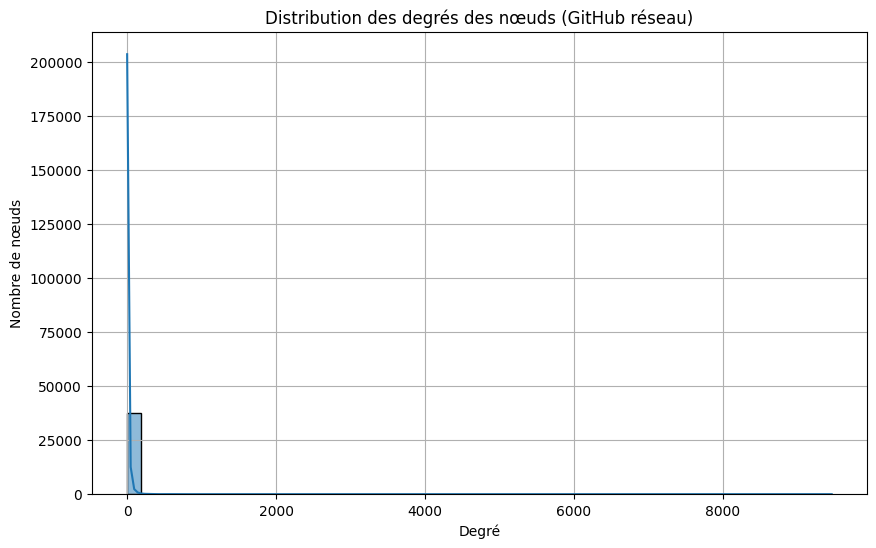

In [ ]:

plt.figure(figsize=(10, 6))
sns.histplot(degrees, bins=50, kde=True)
plt.title("Distribution des degrés des nœuds (GitHub réseau)")
plt.xlabel("Degré")
plt.ylabel("Nombre de nœuds")
plt.grid(True)
plt.show()

random: générer des nombres aléatoires ou de faire des choix aléatoires dans des listes.

In [ ]:
import random

Visualisation d'un échantillon du réseau (3000 noeuds)

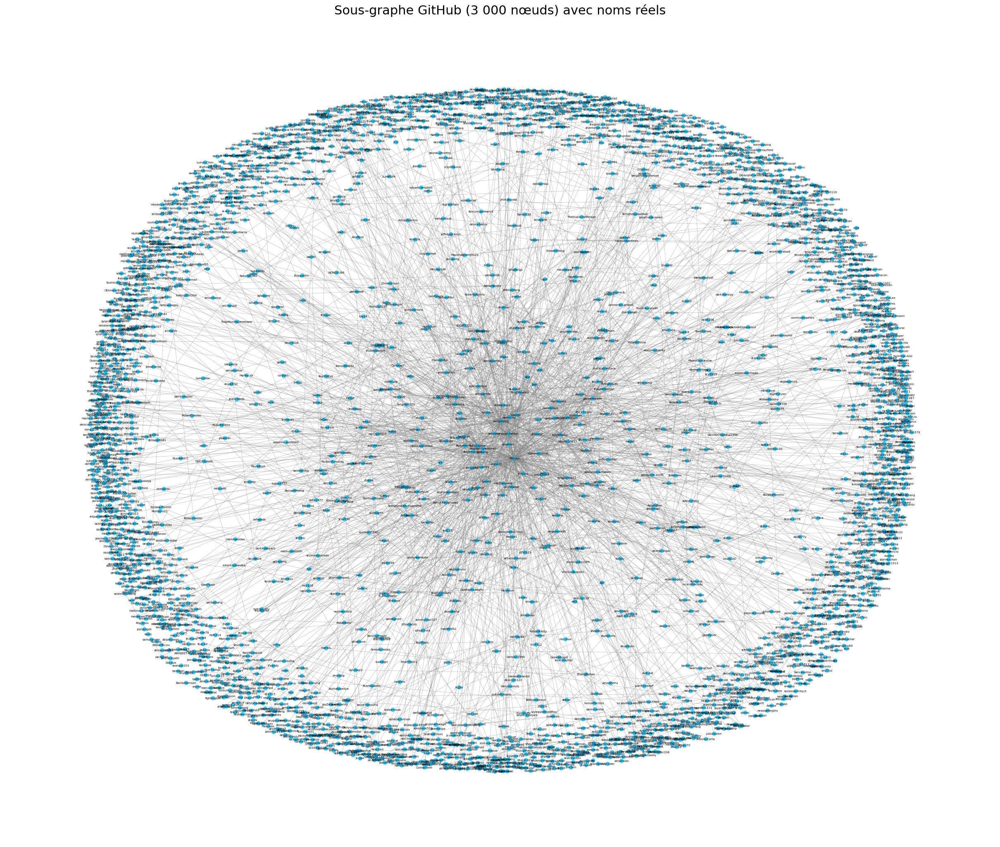

In [ ]:

nodes_df = pd.read_csv('musae_git_target.csv')

#Créer un dictionnaire de correspondance id → name
id_to_name = dict(zip(nodes_df['id'], nodes_df['name']))


node_list = list(G.nodes())
sub_nodes = random.sample(node_list, 3000)
subgraph = G.subgraph(sub_nodes).copy()


pos = nx.spring_layout(subgraph, seed=42, k=0.3) #dispersion

plt.figure(figsize=(24, 20))
nx.draw(
    subgraph,
    pos,
    with_labels=False,
    node_size=40,
    edge_color='gray',
    node_color='deepskyblue',
    alpha=0.7,
    width=0.4
)

labels = {node: id_to_name.get(node, str(node)) for node in subgraph.nodes()}
nx.draw_networkx_labels(
    subgraph,
    pos,
    labels=labels,
    font_size=5,     # taille réduite pour éviter le chevauchement
    font_color='black'
)

plt.title("Sous-graphe GitHub (3 000 nœuds) avec noms réels", fontsize=22)
plt.axis('off')
plt.show()


# **L’analyse** **des** **composants** **connectés**

Un composant est un groupe de nœuds où chaque nœud est accessible depuis un autre

In [ ]:

components = list(nx.connected_components(G)) #composant connectés
components = sorted(components, key=len, reverse=True) #tri des composant(décroissant)
print("Nombre de composants connectés :", len(components))

largest_component_size = len(components[0])
print("Taille du plus grand composant :", largest_component_size)

if len(components) > 1:
    print("Taille du 2e plus grand composant :", len(components[1]))


Nombre de composants connectés : 1
Taille du plus grand composant : 37700


Visualiser le plus grand composant

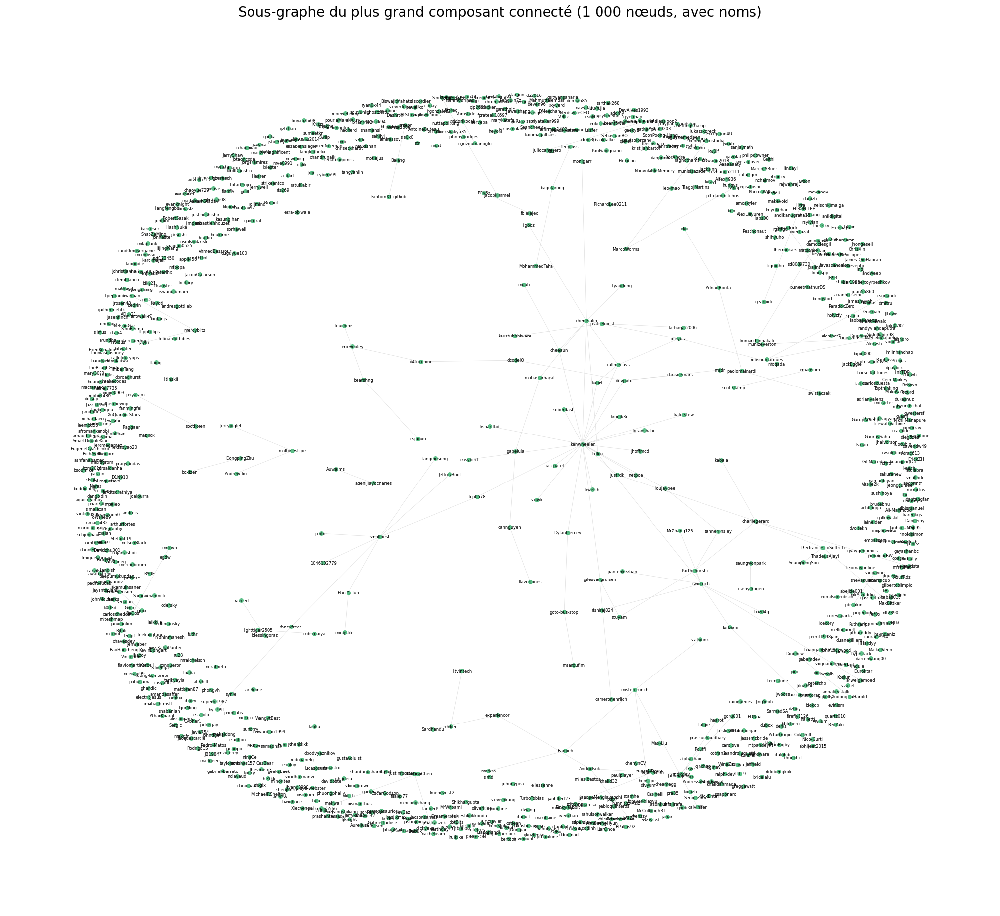

In [ ]:
id_to_name = dict(zip(nodes_df['id'], nodes_df['name']))

components = sorted(nx.connected_components(G), key=len, reverse=True)
G_largest = G.subgraph(components[0]).copy()

sample_nodes = random.sample(list(G_largest.nodes()), min(1000, len(G_largest))) #echantillonage
subgraph = G_largest.subgraph(sample_nodes).copy()

plt.figure(figsize=(20, 18))
pos = nx.spring_layout(subgraph, seed=42, k=0.2)

nx.draw(
    subgraph,
    pos,
    with_labels=False,
    node_size=30,
    edge_color='lightgray',
    node_color='mediumseagreen',
    alpha=0.8,
    width=0.5
)

labels = {node: id_to_name.get(node, str(node)) for node in subgraph.nodes()}
nx.draw_networkx_labels(
    subgraph,
    pos,
    labels=labels,
    font_size=6,
    font_color='black'
)

plt.title("Sous-graphe du plus grand composant connecté (1 000 nœuds, avec noms)", fontsize=20)
plt.axis('off')
plt.show()

# **L’analyse des chemins**

Distance moyenne entre les nœuds

In [ ]:
import networkx as nx
import random

sub_nodes = random.sample(list(G.nodes()), 3000)
subgraph = G.subgraph(sub_nodes).copy() #echantillonage

# Vérifier la connectivité et calculer la longueur moyenne des plus courts chemins
if nx.is_connected(subgraph):
    avg_path_length = nx.average_shortest_path_length(subgraph)
    print("Longueur moyenne des plus courts chemins (sous-graphe 3000 nœuds) :", avg_path_length)
else:
    print("Le sous-graphe n'est pas connexe. Analyse du plus grand composant.")

    #le plus grand composant connecté du sous-graphe
    largest_cc = max(nx.connected_components(subgraph), key=len)
    largest_subgraph = subgraph.subgraph(largest_cc).copy()

    # Calcul de la longueur moyenne sur ce composant
    avg_path_length = nx.average_shortest_path_length(largest_subgraph)
    print("Longueur moyenne des plus courts chemins (plus grand composant du sous-graphe) :", avg_path_length)


Le sous-graphe n'est pas connexe. Analyse du plus grand composant.
Longueur moyenne des plus courts chemins (plus grand composant du sous-graphe) : 4.582185152683739


Chemin le plus long (diamètre) dans le plus grand composant

In [ ]:

    largest_sub_cc = max(nx.connected_components(subgraph), key=len)
    sub_connected = subgraph.subgraph(largest_sub_cc).copy()
    diameter = nx.diameter(sub_connected)
    print("Diamètre du plus grand composant du sous-graphe :", diameter)


Diamètre du plus grand composant du sous-graphe : 12


Visualisation du chemin le plus long

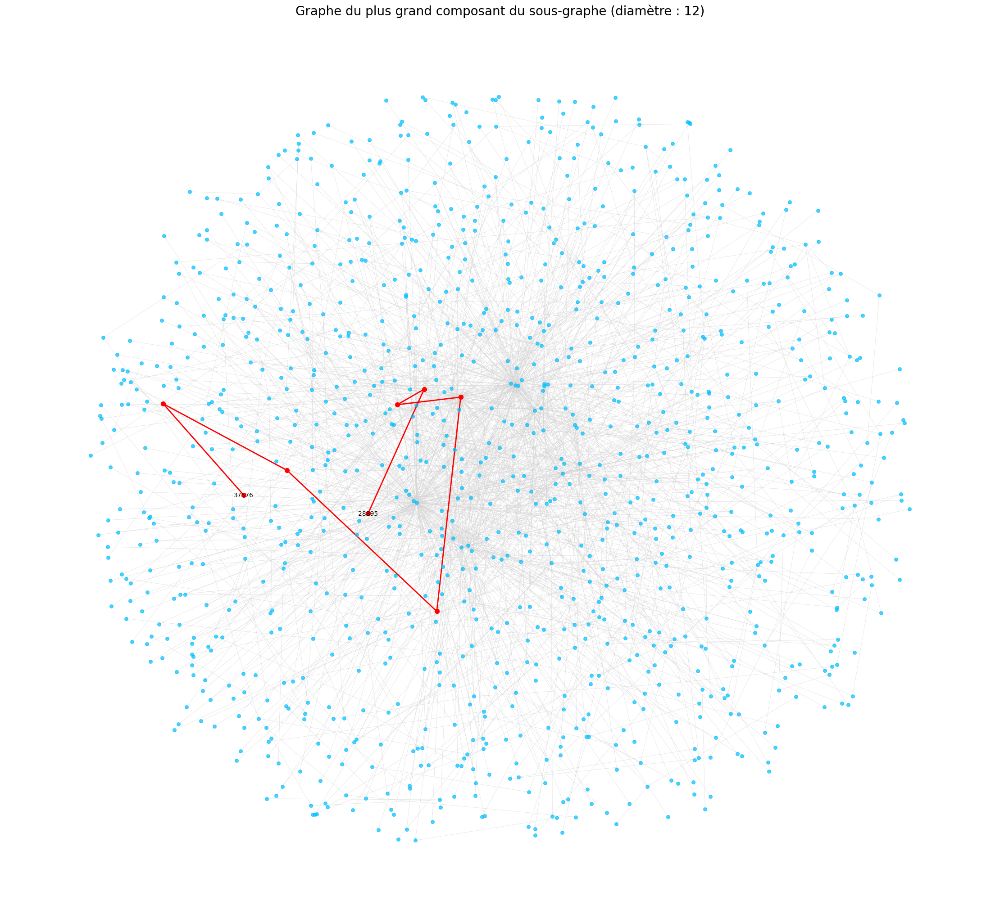

In [ ]:
# Trouver le plus long des plus courts chemins
u = random.choice(list(sub_connected.nodes()))
lengths = nx.single_source_shortest_path_length(sub_connected, u)
v = max(lengths, key=lengths.get)
longest_path = nx.shortest_path(sub_connected, source=u, target=v)

#  Visualisation
plt.figure(figsize=(22, 20))
pos = nx.spring_layout(sub_connected, seed=42, k=0.25)

nx.draw(
    sub_connected,
    pos,
    with_labels=False,
    node_size=30,
    edge_color='lightgray',
    node_color='deepskyblue',
    alpha=0.7,
    width=0.5
)

path_edges = list(zip(longest_path, longest_path[1:]))
nx.draw_networkx_nodes(sub_connected, pos, nodelist=longest_path, node_color='red', node_size=50)
nx.draw_networkx_edges(sub_connected, pos, edgelist=path_edges, edge_color='red', width=2)

labels = {longest_path[0]: str(longest_path[0]), longest_path[-1]: str(longest_path[-1])} #labels des extrimités
nx.draw_networkx_labels(sub_connected, pos, labels=labels, font_size=10, font_color='black')

plt.title(f"Graphe du plus grand composant du sous-graphe (diamètre : {diameter})", fontsize=20)
plt.axis('off')
plt.show()

Calcul et affichage du plus court chemin

In [ ]:

nodes_sample = random.sample(list(subgraph_connected.nodes()), 2)
source, target = nodes_sample
shortest_path = nx.shortest_path(subgraph_connected, source=source, target=target)
print(f"Plus court chemin entre {source} et {target} (dans le plus grand composant du sous-graphe) :")
print(shortest_path)

Plus court chemin entre 17105 et 18672 (dans le plus grand composant du sous-graphe) :
[np.int64(17105), np.int64(33338), np.int64(9075), np.int64(18163), np.int64(18672)]


Visualisation du plus court chemin

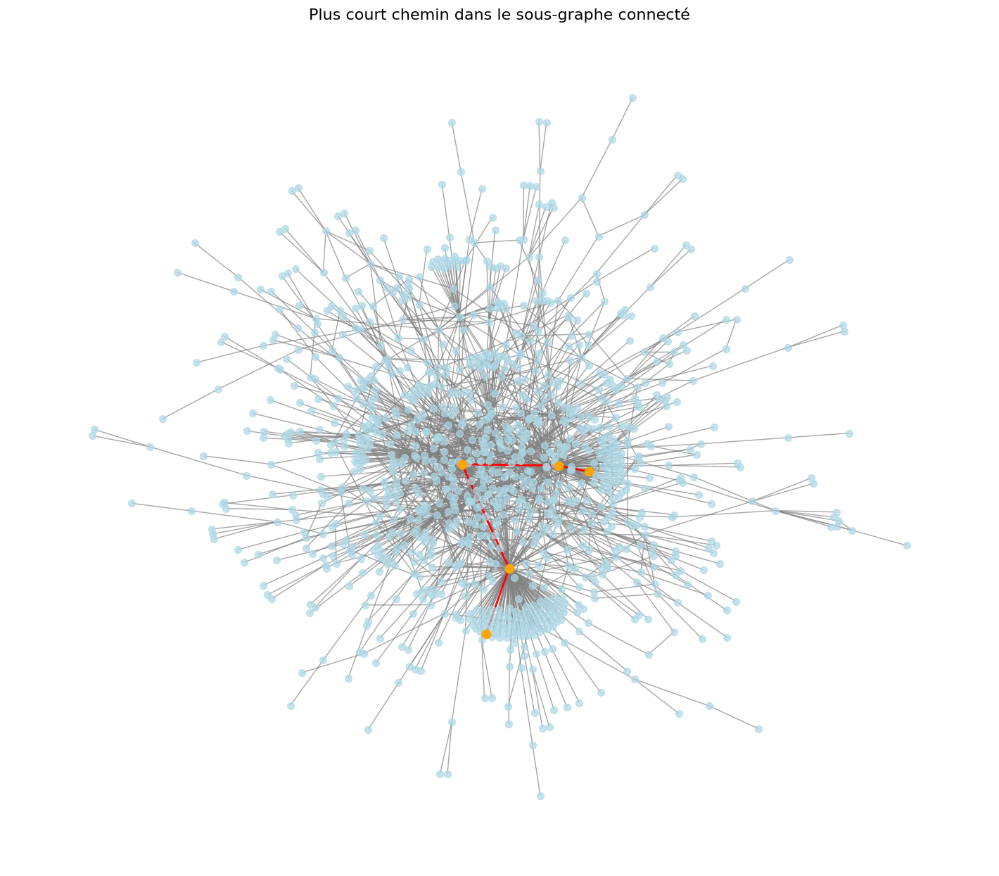

In [ ]:

plt.figure(figsize=(14, 12))
pos = nx.spring_layout(subgraph_connected, seed=42)

# Dessiner les nœuds et arêtes
nx.draw(subgraph_connected, pos, node_color='lightblue', edge_color='gray', node_size=50, alpha=0.7)

# Mettre en surbrillance le chemin
path_edges = list(zip(shortest_path[:-1], shortest_path[1:]))
nx.draw_networkx_nodes(subgraph_connected, pos, nodelist=shortest_path, node_color='orange', node_size=80)
nx.draw_networkx_edges(subgraph_connected, pos, edgelist=path_edges, edge_color='red', width=2)

plt.title("Plus court chemin dans le sous-graphe connecté", fontsize=16)
plt.axis('off')
plt.show()


Plus court chemin entre deux noeuds

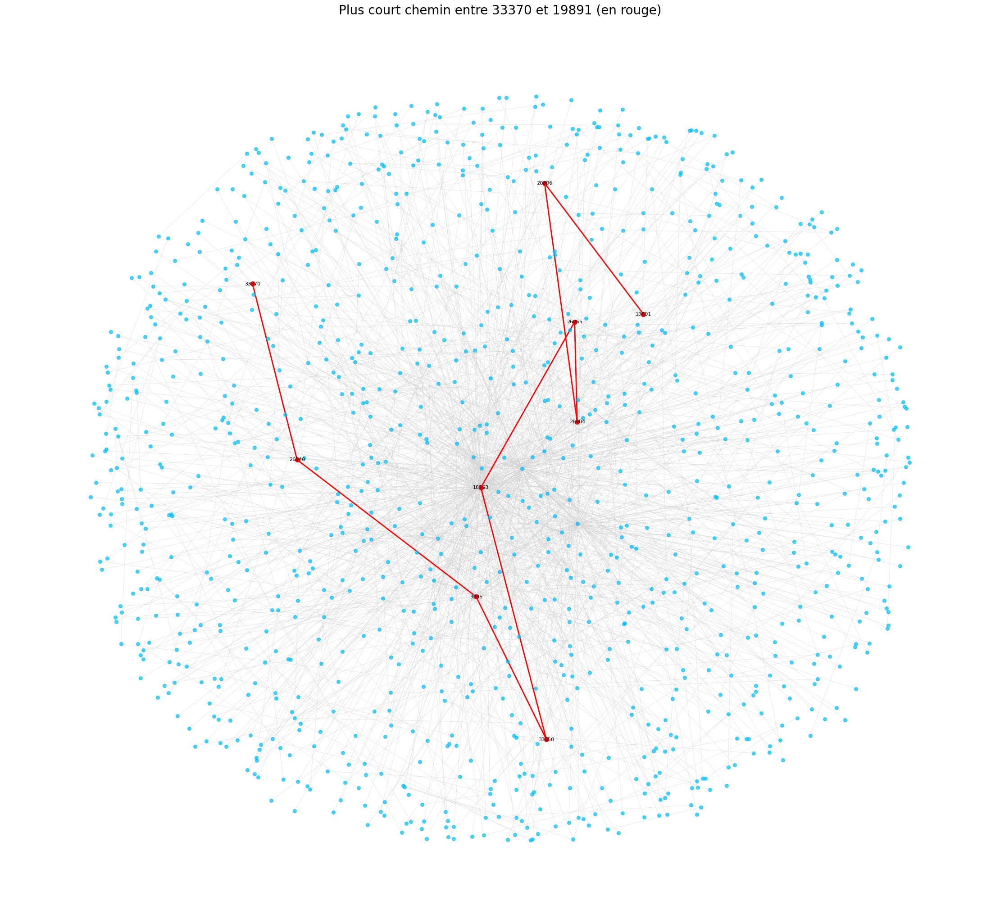

In [ ]:

source, target = random.sample(list(subgraph.nodes()), 2)
shortest_path = nx.shortest_path(subgraph, source=source, target=target)
path_edges = list(zip(shortest_path, shortest_path[1:]))
pos = nx.spring_layout(subgraph, seed=42, k=0.3)

plt.figure(figsize=(22, 20))
nx.draw(
    subgraph,
    pos,
    with_labels=False,
    node_size=30,
    edge_color='lightgray',
    node_color='deepskyblue',
    alpha=0.7,
    width=0.5
)
nx.draw_networkx_nodes(subgraph, pos, nodelist=shortest_path, node_color='red', node_size=50)
nx.draw_networkx_edges(subgraph, pos, edgelist=path_edges, edge_color='red', width=2)

labels = {node: str(node) for node in shortest_path}
nx.draw_networkx_labels(subgraph, pos, labels=labels, font_size=8, font_color='black')

plt.title(f"Plus court chemin entre {source} et {target} (en rouge)", fontsize=20)
plt.axis('off')
plt.show()


# **Le coefficient de clustering et l’analyse de la densité**

-Le coefficient de clustering mesure la tendance des nœuds à former des groupes fermés(triangles).
Plus il est élevé proche de 1, plus le graphe contient des structures communautaires.
-La densité mesure le rapport entre le nombre d’arêtes existantes et le nombre maximal possible.Elle varie de 0 (pas de liens) à 1 (graphe complètement connecté).



In [ ]:

clustering_coeff = nx.average_clustering(sub_connected)
print(" Coefficient de clustering (sous-graphe 3000 nœuds) :", clustering_coeff)


density = nx.density(sub_connected)
print(" Densité du sous-graphe (3000 nœuds) :", density)


 Coefficient de clustering (sous-graphe 3000 nœuds) : 0.1438304908980822
 Densité du sous-graphe (3000 nœuds) : 0.0022644406064095185


Coef de clustering par noeud

In [ ]:

node_clustering = nx.clustering(G)
print(" Coefficient de clustering:", node_clustering)

 Coefficient de clustering: {np.int64(0): 0, np.int64(23977): 0.09879032258064516, np.int64(1): 0.17857142857142858, np.int64(34526): 0, np.int64(2370): 0.17692307692307693, np.int64(14683): 0.03539982030548068, np.int64(29982): 0.03533474135908009, np.int64(21142): 0.026643770884666015, np.int64(20363): 0.03204987165383205, np.int64(23830): 0.049910873440285206, np.int64(34035): 0, np.int64(6067): 0, np.int64(19720): 0.044534412955465584, np.int64(20183): 0, np.int64(3): 0, np.int64(4950): 0, np.int64(18029): 0.08374384236453201, np.int64(3358): 0.09473684210526316, np.int64(34935): 0.09852216748768473, np.int64(5916): 0.19883040935672514, np.int64(4): 0, np.int64(2865): 0, np.int64(9342): 0.19047619047619047, np.int64(5): 0, np.int64(27803): 0.0031992738015873237, np.int64(6): 0.3333333333333333, np.int64(18612): 0.11695906432748537, np.int64(18876): 0.03397064971067743, np.int64(31890): 0.001413281690619859, np.int64(17647): 0.06168831168831169, np.int64(18562): 0.0356938190749079, 

Histogramme de la distribution des coef de clustering

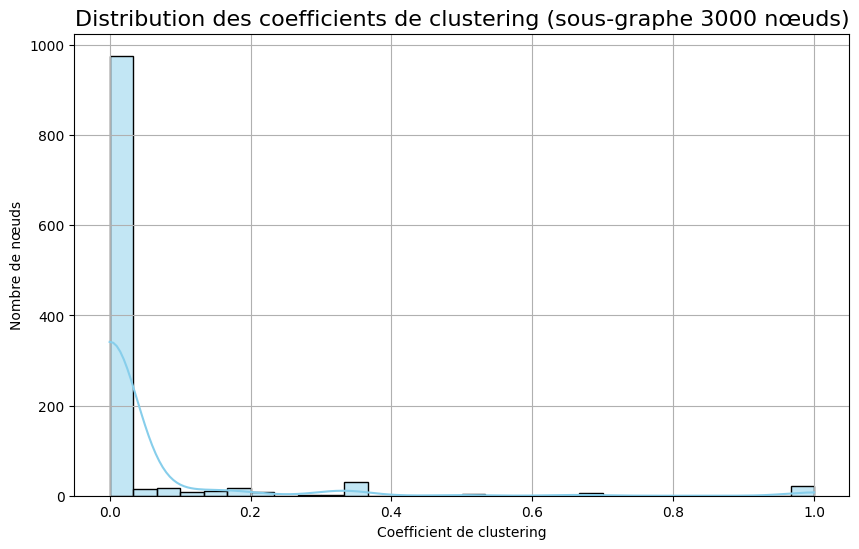

In [ ]:

import seaborn as sns

node_clustering = nx.clustering(sub_connected)

plt.figure(figsize=(10, 6))
sns.histplot(list(node_clustering.values()), bins=30, kde=True, color='skyblue')
plt.title("Distribution des coefficients de clustering (sous-graphe 3000 nœuds)", fontsize=16)
plt.xlabel("Coefficient de clustering")
plt.ylabel("Nombre de nœuds")
plt.grid(True)
plt.show()


Matrice d'adjacence montre visuellement les connexions entre les nœuds.

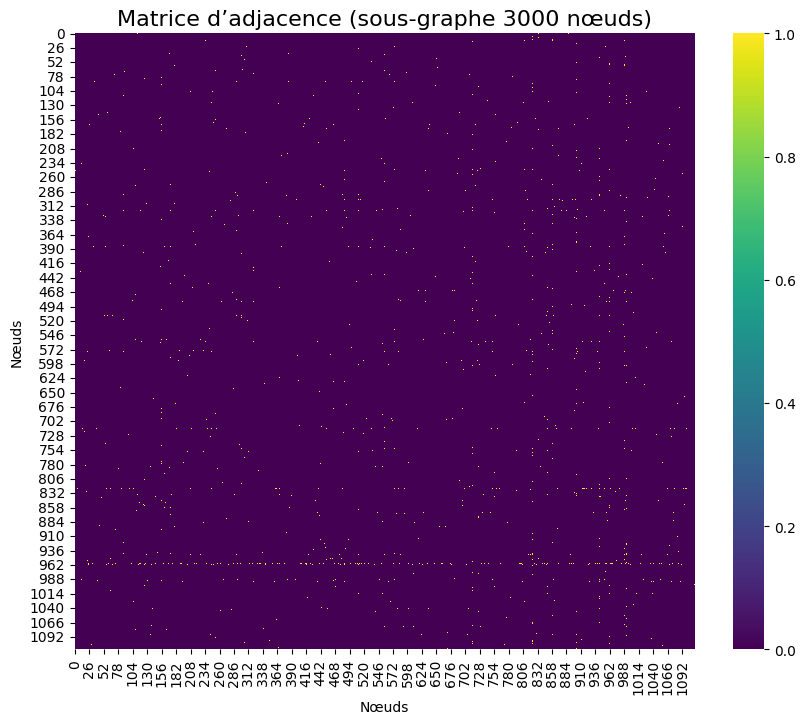

In [ ]:

adj_matrix = nx.to_numpy_array(sub_connected)

plt.figure(figsize=(10, 8))
sns.heatmap(adj_matrix, cmap='viridis', cbar=True)
plt.title("Matrice d’adjacence (sous-graphe 3000 nœuds)", fontsize=16)
plt.xlabel("Nœuds")
plt.ylabel("Nœuds")
plt.show()


# **L’analyse de la centralité**

L’analyse de centralité permet d’identifier les nœuds les plus importants ou influents dans ton réseau.

Centralité en degré: Nombre de connexions d’un nœud — mesure la popularité locale

In [ ]:
deg_centrality = nx.degree_centrality(sub_connected)
top_deg = sorted(deg_centrality.items(), key=lambda x: x[1], reverse=True)[:10]
print(" Top 10 des nœuds par centralité en degré :")
for node, score in top_deg:
    print(f"Nœud {node} → {score:.4f}")

 Top 10 des nœuds par centralité en degré :
Nœud 18163 → 0.1526
Nœud 7027 → 0.1140
Nœud 30199 → 0.0566
Nœud 16119 → 0.0440
Nœud 22321 → 0.0386
Nœud 34114 → 0.0359
Nœud 20854 → 0.0350
Nœud 20173 → 0.0323
Nœud 7825 → 0.0287
Nœud 28217 → 0.0278


Centralité d’intermédiarité: Mesure combien de fois un nœud se trouve sur les chemins les plus courts entre d’autres, repère les ponts critiques.

In [ ]:
between_centrality = nx.betweenness_centrality(sub_connected)
top_betw = sorted(between_centrality.items(), key=lambda x: x[1], reverse=True)[:10]
print("\n Top 10 des nœuds par centralité d’intermédiarité :")
for node, score in top_betw:
    print(f"Nœud {node} → {score:.4f}")



 Top 10 des nœuds par centralité d’intermédiarité :
Nœud 18163 → 0.3563
Nœud 7027 → 0.2587
Nœud 20173 → 0.1073
Nœud 30199 → 0.0833
Nœud 22321 → 0.0805
Nœud 16119 → 0.0777
Nœud 11814 → 0.0726
Nœud 7825 → 0.0550
Nœud 28217 → 0.0544
Nœud 34114 → 0.0543


Centralité de proximité: À quel point un nœud est proche de tous les autres c'est à dire l'efficacité pour atteindre tout le monde.

In [ ]:
closeness_centrality = nx.closeness_centrality(sub_connected)
top_close = sorted(closeness_centrality.items(), key=lambda x: x[1], reverse=True)[:10]
print("\n Top 10 des nœuds par centralité de proximité :")
for node, score in top_close:
    print(f"Nœud {node} → {score:.4f}")



 Top 10 des nœuds par centralité de proximité :
Nœud 18163 → 0.3456
Nœud 20173 → 0.3411
Nœud 7027 → 0.3373
Nœud 11814 → 0.3149
Nœud 10840 → 0.3128
Nœud 9075 → 0.3125
Nœud 11969 → 0.3112
Nœud 25256 → 0.3044
Nœud 28217 → 0.3037
Nœud 16119 → 0.3032


Visualisation avec la centralité en degré

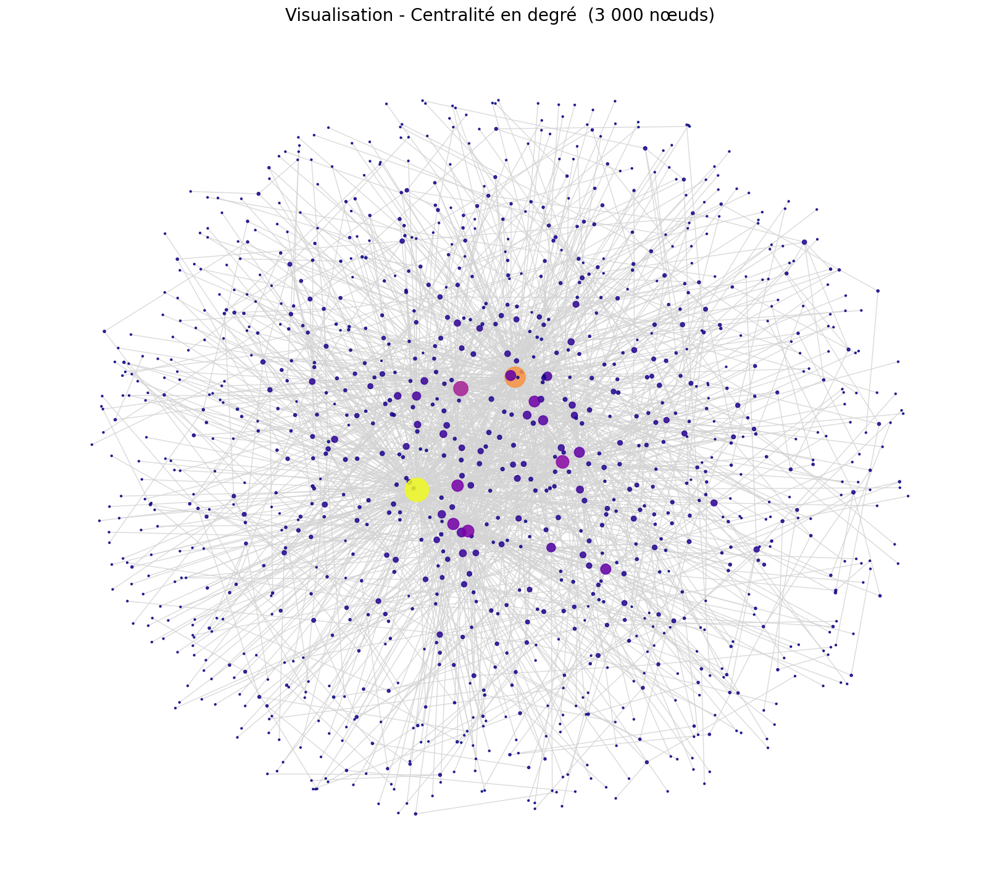

In [ ]:
plt.figure(figsize=(16, 14))
pos = nx.spring_layout(sub_connected, seed=42, k=0.25)
node_sizes = [5000 * deg_centrality[node] for node in sub_connected.nodes()]
nx.draw(
    sub_connected,
    pos,
    with_labels=False,
    node_size=node_sizes,
    node_color=list(deg_centrality.values()),
    cmap=plt.cm.plasma,
    edge_color='lightgray',
    alpha=0.85
)

plt.title("Visualisation - Centralité en degré  (3 000 nœuds)", fontsize=20)
plt.axis('off')
plt.show()



# **Partie 2 : Identification des communautés**

 L'algorithme ***K-clique ***: est une méthode de détection de communautés basée sur les cliques de taille K dans un graphe. Une clique est un sous-ensemble de nœuds dans un graphe où chaque paire de nœuds est directement connectée. L'algorithme K-clique va chercher des sous-graphes où ces cliques de taille K existent

Le sous-graphe contient 1177 nœuds.


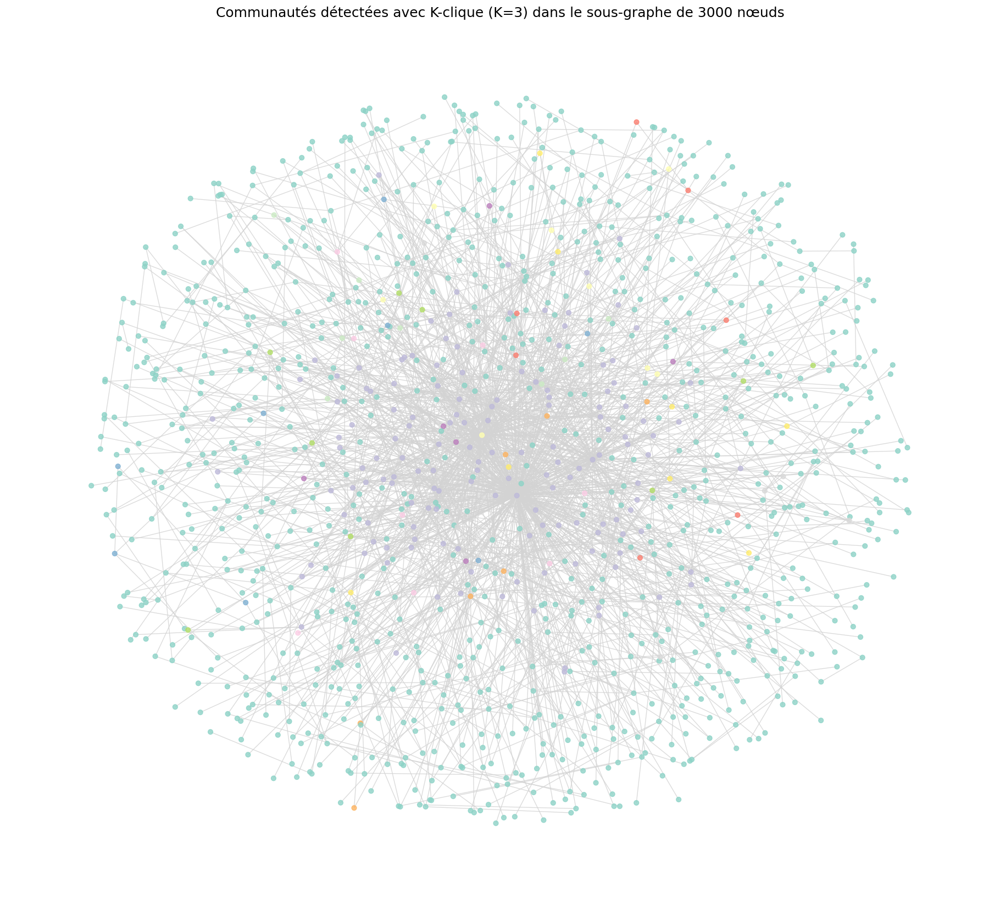

Nombre de communautés détectées : 37


In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
from networkx.algorithms.community import k_clique_communities
import random

num_nodes = len(sub_connected.nodes())
print(f"Le sous-graphe contient {num_nodes} nœuds.")

sample_size = min(num_nodes, 3000)
nodes_sample = random.sample(list(sub_connected.nodes()), sample_size)
subgraph_3000 = sub_connected.subgraph(nodes_sample)

k = 3  # K=3 pour des communautés de taille minimale 3)
cliques = list(k_clique_communities(subgraph_3000, k))

plt.figure(figsize=(18, 16))
pos = nx.spring_layout(subgraph_3000, seed=42, k=0.25)
colors = []
for node in subgraph_3000.nodes():
    assigned = False
    for idx, community in enumerate(cliques):
        if node in community:
            colors.append(idx)
            assigned = True
            break
    if not assigned:
        colors.append(-1)
assert len(colors) == len(subgraph_3000.nodes()), "Le nombre de couleurs ne correspond pas au nombre de nœuds"

nx.draw(
    subgraph_3000, pos,
    node_color=colors,
    with_labels=False,
    node_size=40,
    cmap=plt.cm.Set3,
    edge_color='lightgray',
    alpha=0.8
)
plt.title(f"Communautés détectées avec K-clique (K={k}) dans le sous-graphe de 3000 nœuds", fontsize=18)
plt.axis('off')
plt.show()

print(f"Nombre de communautés détectées : {len(cliques)}")


L'algorithme **Louvain**: Il est utilisé pour partitionner un graphe de manière à maximiser la modularité du réseau. En d'autres termes, il cherche à regrouper les nœuds du graphe de façon à ce que les nœuds dans un même groupe (ou communauté) soient plus fortement connectés entre eux qu'avec les nœuds des autres groupes.
La modularité est une mesure de la qualité d'une partition du graphe. Une modularité élevée indique que la plupart des arêtes sont à l'intérieur des communautés, et très peu entre les communautés.


In [ ]:
pip install python-louvain

In [ ]:
import community

In [ ]:

node_list = list(G.nodes())
sub_nodes = random.sample(node_list, 3000)
subgraph = G.subgraph(sub_nodes).copy()


In [ ]:
#Plus grand composant connecté du sous-graphe
largest_cc = max(nx.connected_components(subgraph), key=len)
sub_connected = subgraph.subgraph(largest_cc).copy()
print(f" Sous-graphe connecté : {sub_connected.number_of_nodes()} nœuds")

 Sous-graphe connecté : 1351 nœuds


In [ ]:
import community.community_louvain as community_louvain


In [ ]:

partition = community_louvain.best_partition(sub_connected)


In [ ]:

num_communities = len(set(partition.values()))
print(f" Nombre de communautés détectées : {num_communities}")

 Nombre de communautés détectées : 30


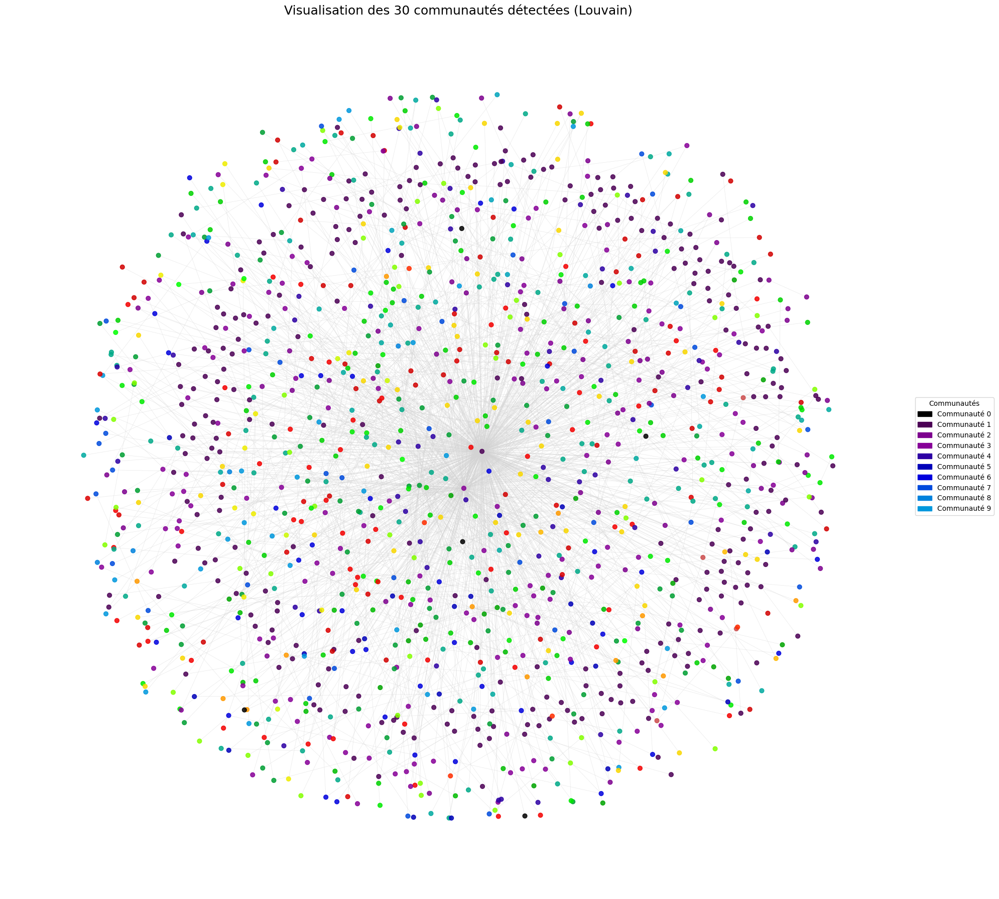

In [ ]:

pos = nx.spring_layout(sub_connected, seed=42, k=0.25)
cmap = plt.colormaps['nipy_spectral']
colors = [cmap(partition[node] / num_communities) for node in sub_connected.nodes()]

plt.figure(figsize=(20, 18))
nx.draw_networkx_edges(sub_connected, pos, edge_color='lightgray', alpha=0.5, width=0.5)
nx.draw_networkx_nodes(
    sub_connected,
    pos,
    node_color=colors,
    node_size=40,
    alpha=0.85
)
handles = [
    mpatches.Patch(color=cmap(i / num_communities), label=f"Communauté {i}")
    for i in sorted(set(partition.values()))[:10]
]
plt.legend(handles=handles, loc='center left', bbox_to_anchor=(1, 0.5), title="Communautés")

plt.title("Visualisation des 30 communautés détectées (Louvain)", fontsize=18)
plt.axis('off')
plt.tight_layout()
plt.show()

L'algorithme **propagation des labels** : est une méthode non supervisée utilisée pour la détection de communautés dans les graphes. Il est simple, rapide, et fonctionne bien pour des graphes de grande taille, tout en étant basé sur une dynamique locale de propagation de "labels" entre les nœuds d'un graphe.

In [ ]:

import matplotlib.patches as mpatches

from networkx.algorithms.community import label_propagation_communities

communities_lp = list(label_propagation_communities(sub_connected))

#Création d’un dictionnaire node → communauté
partition_lp = {}
for i, community in enumerate(communities_lp):
    for node in community:
        partition_lp[node] = i

num_communities = len(communities_lp)
print(f" Nombre de communautés détectées (Label Propagation) : {num_communities}")


 Nombre de communautés détectées (Label Propagation) : 153


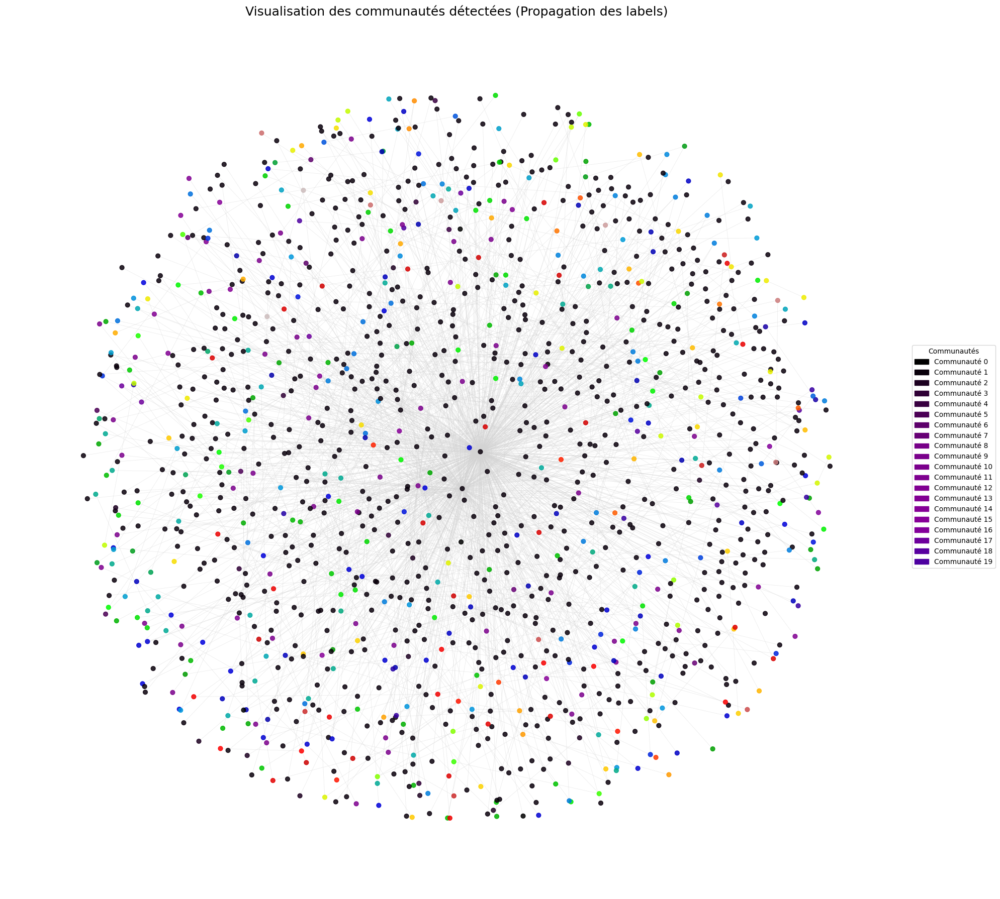

In [ ]:

cmap = plt.colormaps['nipy_spectral']
colors = [cmap(i / num_communities) for i in range(num_communities)]

pos = nx.spring_layout(sub_connected, seed=42, k=0.25)
node_colors = [cmap(partition_lp[node] / num_communities) for node in sub_connected.nodes()]

plt.figure(figsize=(20, 18))
nx.draw_networkx_edges(sub_connected, pos, edge_color='lightgray', alpha=0.5, width=0.5)
nx.draw_networkx_nodes(
    sub_connected,
    pos,
    node_color=node_colors,
    node_size=40,
    alpha=0.85
)
handles = [
    mpatches.Patch(color=cmap(i / num_communities), label=f"Communauté {i}")
    for i in sorted(set(partition_lp.values()))[:20]
]
plt.legend(handles=handles, loc='center left', bbox_to_anchor=(1, 0.5), title="Communautés")

plt.title("Visualisation des communautés détectées (Propagation des labels)", fontsize=18)
plt.axis('off')
plt.tight_layout()
plt.show()

L'algorithme **infomap**: est une méthode puissante pour la détection de communautés dans des réseaux, particulièrement adaptée pour des graphes de grande taille. Il repose sur une approche inspirée de la théorie de l'information, en utilisant l'idée de compression de l'information pour identifier des communautés dans un réseau.

In [ ]:
pip install infomap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 264.8/264.8 kB 13.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for infomap: filename=infomap-2.8.0-cp311-cp311-linux_x86_64.whl size=7698806 sha256=d0642884a43f407ef332e9995a21bd7e98aff7223c87c1f8ffaa2d7309160b35
  Stored in directory: /root/.cache/pip/wheels/f2/07/de/ee649642ec15485c0eaf89c9f06eb4f19a9b45e744e6808a8d
Successfully built infomap


In [ ]:
import infomap

In [ ]:


# mapper les nœuds à des indices
node_map = {node: i for i, node in enumerate(sub_connected.nodes())}
im = infomap.Infomap()
for edge in sub_connected.edges():
    node1, node2 = edge
    im.addLink(node_map[node1], node_map[node2])  # Ajouter les arêtes avec les indices
im.run()
communities = im.getModules()
print("Communautés détectées :")
print(communities)


Communautés détectées :
{0: 101, 1: 1, 2: 14, 3: 1, 4: 1, 5: 34, 6: 2, 7: 1, 8: 86, 9: 93, 10: 21, 11: 72, 12: 129, 13: 1, 14: 5, 15: 111, 16: 1, 17: 20, 18: 1, 19: 29, 20: 92, 21: 82, 22: 32, 23: 4, 24: 1, 25: 2, 26: 65, 27: 1, 28: 6, 29: 130, 30: 28, 31: 165, 32: 59, 33: 164, 34: 21, 35: 20, 36: 1, 37: 2, 38: 30, 39: 2, 40: 161, 41: 2, 42: 18, 43: 115, 44: 28, 45: 8, 46: 1, 47: 41, 48: 1, 49: 34, 50: 62, 51: 1, 52: 106, 53: 4, 54: 123, 55: 28, 56: 2, 57: 1, 58: 1, 59: 146, 60: 2, 61: 4, 62: 1, 63: 2, 64: 32, 65: 47, 66: 160, 67: 1, 68: 22, 69: 73, 70: 1, 71: 12, 72: 3, 73: 69, 74: 11, 75: 102, 76: 13, 77: 40, 78: 60, 79: 87, 80: 1, 81: 26, 82: 63, 83: 40, 84: 21, 85: 83, 86: 27, 87: 24, 88: 3, 89: 1, 90: 25, 91: 17, 92: 142, 93: 41, 94: 20, 95: 96, 96: 2, 97: 2, 98: 22, 99: 1, 100: 29, 101: 30, 102: 30, 103: 23, 104: 90, 105: 1, 106: 121, 107: 119, 108: 4, 109: 112, 110: 1, 111: 6, 112: 3, 113: 1, 114: 79, 115: 76, 116: 23, 117: 2, 118: 16, 119: 51, 120: 46, 121: 153, 122: 112, 123: 

<ipython-input-66-9a586602c725>:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', num_communities)  # 'tab20' fournit des couleurs distinctes
<ipython-input-66-9a586602c725>:33: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


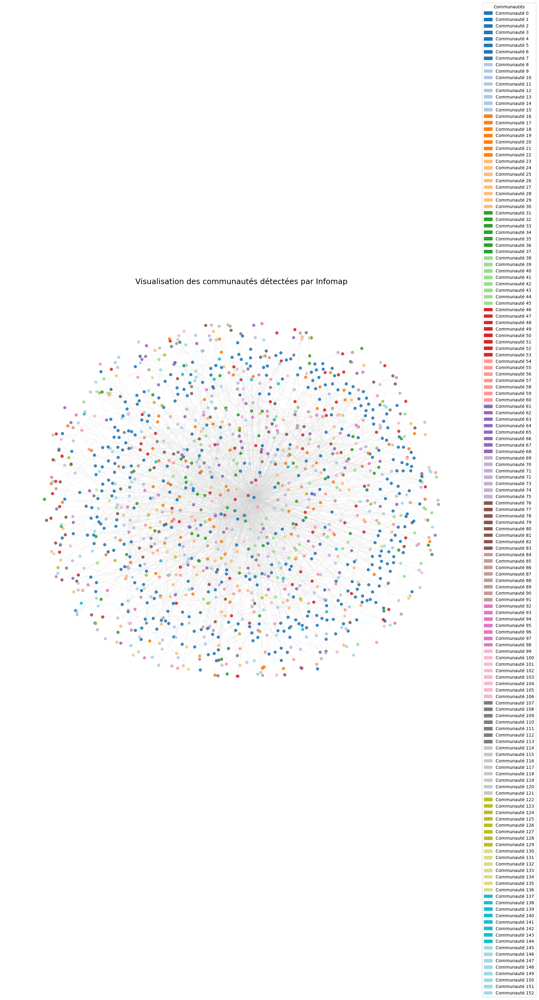

In [ ]:

pos = nx.spring_layout(sub_connected, seed=42, k=0.25)
cmap = plt.cm.get_cmap('tab20', num_communities)
node_community = {node: communities[node_map[node]] for node in sub_connected.nodes()}
node_colors = [cmap(node_community[node] / num_communities) for node in sub_connected.nodes()]
plt.figure(figsize=(20, 18))
nx.draw_networkx_edges(sub_connected, pos, edge_color='lightgray', alpha=0.5, width=0.5)
nx.draw_networkx_nodes(
    sub_connected,
    pos,
    node_color=node_colors,
    node_size=40,
    alpha=0.85
)

handles = [
    mpatches.Patch(color=cmap(i / num_communities), label=f"Communauté {i}")
    for i in range(num_communities)
]
plt.legend(handles=handles, loc='center left', bbox_to_anchor=(1, 0.5), title="Communautés")

plt.title("Visualisation des communautés détectées par Infomap", fontsize=18)
plt.axis('off')
plt.tight_layout()
plt.show()

1. K-Clique : 37 communautés

L'algorithme K-Clique a trouvé 37 communautés. Cet algorithme fonctionne bien lorsqu'il existe des sous-structures assez denses dans le réseau. Cependant, un grand nombre de communautés pourrait signifier que l'algorithme est sensible aux petites fluctuations de structure et aux "bruits" dans le réseau.
2. Louvain : 30 communautés

Avec 30 communautés, Louvain semble avoir trouvé un nombre relativement équilibré de communautés. Louvain est très efficace pour des réseaux bien structurés et quand on cherche à maximiser la modularité, donc à détecter des communautés bien séparées.
3. Propagation des labels : 153 communautés

153 communautés est un nombre très élevé comparé aux autres algorithmes. Cela pourrait indiquer que l'algorithme de propagation des labels a une tendance à produire des communautés trop petites, surtout si le réseau est très dense ou mal structuré.
4. Infomap : Très nombreux résultats

Infomap a donné un nombre de communautés très élevé. Cela pourrait être dû à la manière dont Infomap cherche à minimiser l'entropie et à créer des communautés très fines. L'algorithme peut générer beaucoup de petites communautés dans un réseau complexe, et cela peut nuire à l'interprétation globale des résultats.